# Cervix lugol/normal/green imagery classification with a custom NN

In [1]:
# https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

In [2]:
import os
from datetime import datetime
import numpy as np
import cv2
import warnings
warnings.filterwarnings("ignore")

# Project
import sys
sys.path.append(os.path.join(os.path.abspath(os.path.dirname('.')), '..', 'common'))

import matplotlib.pylab as plt
%matplotlib inline

def plt_st(n, m):
    plt.figure(figsize=(n, m))

## Classify all trainval and test data

Result of classification are 3 files : 
- `green_trainval_id_type_list.npz` stores `green_trainval_id_type_list` id/types of green imagery
- `green_test_id_type_list.npz` stores `green_test_id_type_list` id/types of green imagery

- `lugol_trainval_id_type_list.npz` stores `lugol_trainval_id_type_list` id/types of lugol iodine imagery
- `lugol_test_id_type_list.npz` stores `lugol_test_id_type_list` id/types of lugol iodine imagery

- `normal_trainval_id_type_list.npz` stores `normal_trainval_id_type_list` id/types of normal imagery
- `normal_test_id_type_list.npz` stores `normal_test_id_type_list` id/types of normal imagery

In [4]:
from xy_providers import DataCache
cache = DataCache(0)

In [6]:
# Load images
from training_utils import get_all_trainval_id_type_list
from data_utils import test_ids, GENERATED_DATA

all_trainval_id_type_list = get_all_trainval_id_type_list(n_images_per_class=-1)

test_id_type_list = []
for image_id in test_ids:
    test_id_type_list.append((image_id, "Test"))
    
print("Length of all_trainval_id_type_list:", len(all_trainval_id_type_list))
print("Length of test_id_type_list:", len(test_id_type_list))

('Length of all_trainval_id_type_list:', 7060)
('Length of test_id_type_list:', 512)


### Green imagery

In [7]:
from imagery_classification.green import is_green_type

In [8]:
from imagery_classification.lugol_nonlugol import cached_image_provider as xy_provider

def generate_green_id_type_list(id_type_list, cache):    
    out = []
    ll = len(id_type_list)
    image_size = (299, 299)
    p = xy_provider(id_type_list,
                    cache=cache,
                    image_size=image_size)
    counter = 1
    ll = len(id_type_list)
    for img, _, info in p:
        if counter % 20 == 0:
            print('-- %i / %i' % (counter, ll))        
        counter += 1
        img = img.transpose([1, 2, 0])
        img = (255.0 * img).astype(np.uint8)
        if is_green_type(img):
            out.append((info[0], info[1]))
    return out
    


In [167]:
trainval_green_id_type_list = generate_green_id_type_list(all_trainval_id_type_list, cache)

-- 20 / 7060
-- 40 / 7060
-- 60 / 7060
-- 80 / 7060
-- 100 / 7060
-- 120 / 7060
-- 140 / 7060
-- 160 / 7060
-- 180 / 7060
-- 200 / 7060
-- 220 / 7060
-- 240 / 7060
-- 260 / 7060
-- 280 / 7060
-- 300 / 7060
-- 320 / 7060
-- 340 / 7060
-- 360 / 7060
-- 380 / 7060
-- 400 / 7060
-- 420 / 7060
-- 440 / 7060
-- 460 / 7060
-- 480 / 7060
-- 500 / 7060
-- 520 / 7060
-- 540 / 7060
-- 560 / 7060
-- 580 / 7060
-- 600 / 7060
-- 620 / 7060
-- 640 / 7060
-- 660 / 7060
-- 680 / 7060
-- 700 / 7060
-- 720 / 7060
-- 740 / 7060
-- 760 / 7060
-- 780 / 7060
-- 800 / 7060
-- 820 / 7060
-- 840 / 7060
-- 860 / 7060
-- 880 / 7060
-- 900 / 7060
-- 920 / 7060
-- 940 / 7060
-- 960 / 7060
-- 980 / 7060
-- 1000 / 7060
-- 1020 / 7060
-- 1040 / 7060
-- 1060 / 7060
-- 1080 / 7060
-- 1100 / 7060
-- 1120 / 7060
-- 1140 / 7060
-- 1160 / 7060
-- 1180 / 7060
-- 1200 / 7060
-- 1220 / 7060
-- 1240 / 7060
-- 1260 / 7060
-- 1280 / 7060
-- 1300 / 7060
-- 1320 / 7060
-- 1340 / 7060
-- 1360 / 7060
-- 1380 / 7060
-- 1400 / 7060
-- 

In [168]:
np.savez_compressed(os.path.join(GENERATED_DATA, "green_id_type_list.npz"), green_id_type_list=trainval_green_id_type_list)

In [169]:
len(trainval_green_id_type_list)

541

In [170]:
test_green_id_type_list = generate_green_id_type_list(test_id_type_list, cache)
np.savez_compressed(os.path.join(GENERATED_DATA, "test_green_id_type_list.npz"), test_green_test_id_type_list=test_green_id_type_list)

-- 20 / 512
-- 40 / 512
-- 60 / 512
-- 80 / 512
-- 100 / 512
-- 120 / 512
-- 140 / 512
-- 160 / 512
-- 180 / 512
-- 200 / 512
-- 220 / 512
-- 240 / 512
-- 260 / 512
-- 280 / 512
-- 300 / 512
-- 320 / 512
-- 340 / 512
-- 360 / 512
-- 380 / 512
-- 400 / 512
-- 420 / 512
-- 440 / 512
-- 460 / 512
-- 480 / 512
-- 500 / 512


In [171]:
len(test_green_id_type_list)

0

### Lugol/Normal imagery

In [172]:
trainval_lugol_normal_id_type_list = list(all_trainval_id_type_list)
trainval_lugol_normal_id_type_list = list(set(trainval_lugol_normal_id_type_list) - set(trainval_green_id_type_list))
print len(trainval_lugol_normal_id_type_list)

test_lugol_normal_id_type_list = list(test_id_type_list)
test_lugol_normal_id_type_list = list(set(test_lugol_normal_id_type_list) - set(test_green_id_type_list))
print len(test_lugol_normal_id_type_list)


6519
512


In [106]:
from data_utils import get_filename
from preprocessing.image.generators import ImageDataGenerator

        
def _get_generator(save_prefix):
    # Initialize generator
    gen = ImageDataGenerator(featurewise_center=True, featurewise_std_normalization=True)

    # Load mean, std, principal_components if file exists
    filename = os.path.join(GENERATED_DATA, save_prefix + "_stats.npz")
    assert os.path.exists(filename), "WTF"
    print("Load existing file: %s" % filename)
    npzfile = np.load(filename)
    gen.mean = npzfile['mean']
    gen.std = npzfile['std']
    return gen


def generate_test_lugol_nonlugol_id_type_list(save_prefix, net, cache, image_size=(299, 299)):    
    batch_size = 16
    gen = _get_generator(save_prefix)            
    # Iterate over data and predict
    flow = gen.flow(xy_provider(test_lugol_normal_id_type_list,
                            cache=cache,
                            image_size=image_size),
                # Ensure that all batches have the same size
                len(test_id_type_list),
                batch_size=batch_size)
    lugol_id_type_list = []
    counter = 1
    ll = len(test_id_type_list)
    for x, _, info in flow:               
        y_pred = net.predict(x)   
        for i in range(y_pred.shape[0]):
            print('-- %i / %i : %s, %s -> %f' % (counter, ll, info[i][0], info[i][1], y_pred[i][0]))
            image_id = info[i][0] + '_' + info[i][1]
            counter += 1
            lugol_id_type_list.append((info[i][0], info[i][1], y_pred[i][0]))
    return lugol_id_type_list
            
def generate_lugol_nonlugol_id_type_list(save_prefix, net, cache, image_size=(299, 299)):
    
    batch_size = 16
    gen = _get_generator(save_prefix)            
    # Iterate over data and predict
    flow = gen.flow(xy_provider(trainval_lugol_normal_id_type_list,
                            cache=cache,
                            image_size=image_size),
                    # Ensure that all batches have the same size
                    len(all_trainval_id_type_list),
                    batch_size=batch_size)
    
    lugol_id_type_list = []
    counter = 1
    ll = len(all_trainval_id_type_list)
    for x, _, info in flow:                
        y_pred = net.predict(x)   
        for i in range(y_pred.shape[0]):
            print('-- %i / %i : %s, %s -> %f' % (counter, ll, info[i][0], info[i][1], y_pred[i][0]))        
            counter += 1
            lugol_id_type_list.append((info[i][0], info[i][1], y_pred[i][0]))
    return lugol_id_type_list

### Model one 

In [101]:
from imagery_classification.lugol_nonlugol import get_cnn_1

## Setup model
optimizer = 'adam'
lr_base = 0.01
cnn = get_cnn_1(optimizer=optimizer, lr=lr_base)

save_prefix="cervix_lugol_nonlugol_classification_1_opt=adam_seed=12345"
best_weights_filename="weights/cervix_lugol_nonlugol_classification_1_opt=adam_seed=12345_24_val_loss=0.0848_val_acc=0.9668_val_precision=0.9558_val_recall=0.9531.h5"
if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    cnn.load_weights(best_weights_filename)

('Load found weights: ', 'weights/cervix_lugol_nonlugol_classification_1_opt=adam_seed=12345_24_val_loss=0.0848_val_acc=0.9668_val_precision=0.9558_val_recall=0.9531.h5')


In [102]:
lugol_id_type_list = generate_lugol_nonlugol_id_type_list(save_prefix, cnn, cache)

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_1_opt=adam_seed=12345_stats.npz
-- 1 / 7060 : 209, AType_2
-- 2 / 7060 : 6741, AType_2
-- 3 / 7060 : 1701, AType_2
-- 4 / 7060 : 1445, Type_2
-- 5 / 7060 : 4079, AType_3
-- 6 / 7060 : 1268, Type_3
-- 7 / 7060 : 3024, AType_2
-- 8 / 7060 : 5207, AType_3
-- 9 / 7060 : 410, Type_2
-- 10 / 7060 : 1465, AType_1
-- 11 / 7060 : 625, Type_3
-- 12 / 7060 : 997, AType_2
-- 13 / 7060 : 170, AType_2
-- 14 / 7060 : 3064, AType_2
-- 15 / 7060 : 1191, AType_3
-- 16 / 7060 : 67, Type_2
-- 17 / 7060 : 6006, AType_3
-- 18 / 7060 : 378, Type_2
-- 19 / 7060 : 4810, AType_3
-- 20 / 7060 : 350, Type_3
-- 21 / 7060 : 63, Type_3
-- 22 / 7060 : 1289, Type_1
-- 23 / 7060 : 2395, AType_2
-- 24 / 7060 : 2889, AType_2
-- 25 / 7060 : 798, Type_2
-- 26 / 7060 : 6565, AType_2
-- 27 / 7060 : 755, AType_1
-- 28 / 7060 : 1351, AType_2
-- 29 / 7060 : 2149, AType_3
-- 30 / 7060 : 964, Type_2
-- 31 / 7

In [104]:
np.savez_compressed(os.path.join(GENERATED_DATA, "lugol_id_type_list_1.npz"), lugol_id_type_list=lugol_id_type_list)

In [105]:
test_lugol_id_type_list = generate_test_lugol_nonlugol_id_type_list(save_prefix, cnn, cache)

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_1_opt=adam_seed=12345_stats.npz
-- 1 / 512 : 420, Test
-- 2 / 512 : 51, Test
-- 3 / 512 : 246, Test
-- 4 / 512 : 415, Test
-- 5 / 512 : 102, Test
-- 6 / 512 : 327, Test
-- 7 / 512 : 471, Test
-- 8 / 512 : 271, Test
-- 9 / 512 : 451, Test
-- 10 / 512 : 385, Test
-- 11 / 512 : 418, Test
-- 12 / 512 : 34, Test
-- 13 / 512 : 237, Test
-- 14 / 512 : 42, Test
-- 15 / 512 : 207, Test
-- 16 / 512 : 319, Test
-- 17 / 512 : 394, Test
-- 18 / 512 : 409, Test
-- 19 / 512 : 478, Test
-- 20 / 512 : 368, Test
-- 21 / 512 : 3, Test
-- 22 / 512 : 137, Test
-- 23 / 512 : 447, Test
-- 24 / 512 : 501, Test
-- 25 / 512 : 221, Test
-- 26 / 512 : 136, Test
-- 27 / 512 : 200, Test
-- 28 / 512 : 19, Test
-- 29 / 512 : 484, Test
-- 30 / 512 : 260, Test
-- 31 / 512 : 128, Test
-- 32 / 512 : 363, Test
-- 33 / 512 : 60, Test
-- 34 / 512 : 290, Test
-- 35 / 512 : 504, Test
-- 36 / 512 : 159, Te

In [107]:
np.savez_compressed(os.path.join(GENERATED_DATA, "test_lugol_id_type_list_1.npz"), test_lugol_id_type_list=test_lugol_id_type_list)

In [108]:
test_lugol_id_type_list[1]

('51', 'Test', 5.6047946e-07)

### Model two 

In [109]:
from imagery_classification.lugol_nonlugol import get_cnn_3

## Setup model
optimizer = 'adam'
lr_base = 0.01
cnn = get_cnn_3(optimizer=optimizer, lr=lr_base)

save_prefix="cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345"
best_weights_filename="weights/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_17_val_loss=0.1048_val_acc=0.9609_val_precision=0.9525_val_recall=0.9419.h5"
if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    cnn.load_weights(best_weights_filename)

('Load found weights: ', 'weights/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_17_val_loss=0.1048_val_acc=0.9609_val_precision=0.9525_val_recall=0.9419.h5')


In [110]:
lugol_id_type_list = generate_lugol_nonlugol_id_type_list(save_prefix, cnn, cache)

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_stats.npz
-- 1 / 7060 : 209, AType_2 -> 0.009505
-- 2 / 7060 : 6741, AType_2 -> 0.000016
-- 3 / 7060 : 1701, AType_2 -> 0.000144
-- 4 / 7060 : 1445, Type_2 -> 0.019217
-- 5 / 7060 : 4079, AType_3 -> 0.005027
-- 6 / 7060 : 1268, Type_3 -> 0.000167
-- 7 / 7060 : 3024, AType_2 -> 0.000052
-- 8 / 7060 : 5207, AType_3 -> 0.958973
-- 9 / 7060 : 410, Type_2 -> 0.000000
-- 10 / 7060 : 1465, AType_1 -> 0.500395
-- 11 / 7060 : 625, Type_3 -> 0.000188
-- 12 / 7060 : 997, AType_2 -> 0.002089
-- 13 / 7060 : 170, AType_2 -> 0.989294
-- 14 / 7060 : 3064, AType_2 -> 0.000637
-- 15 / 7060 : 1191, AType_3 -> 0.992843
-- 16 / 7060 : 67, Type_2 -> 0.001087
-- 17 / 7060 : 6006, AType_3 -> 0.001475
-- 18 / 7060 : 378, Type_2 -> 0.000008
-- 19 / 7060 : 4810, AType_3 -> 0.973159
-- 20 / 7060 : 350, Type_3 -> 0.708763
-- 21 / 7060 : 63, Type_3 -> 0.998960
-- 22 / 7060

In [111]:
np.savez_compressed(os.path.join(GENERATED_DATA, "lugol_id_type_list_2.npz"), lugol_id_type_list=lugol_id_type_list)

In [112]:
test_lugol_id_type_list = generate_test_lugol_nonlugol_id_type_list(save_prefix, cnn, cache)

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_3_opt=adam_seed=12345_stats.npz
-- 1 / 512 : 420, Test -> 0.005620
-- 2 / 512 : 51, Test -> 0.000005
-- 3 / 512 : 246, Test -> 0.000006
-- 4 / 512 : 415, Test -> 0.000942
-- 5 / 512 : 102, Test -> 0.947296
-- 6 / 512 : 327, Test -> 0.048741
-- 7 / 512 : 471, Test -> 0.000003
-- 8 / 512 : 271, Test -> 0.992204
-- 9 / 512 : 451, Test -> 0.797149
-- 10 / 512 : 385, Test -> 0.088237
-- 11 / 512 : 418, Test -> 0.003155
-- 12 / 512 : 34, Test -> 0.613872
-- 13 / 512 : 237, Test -> 0.060812
-- 14 / 512 : 42, Test -> 0.002270
-- 15 / 512 : 207, Test -> 0.959025
-- 16 / 512 : 319, Test -> 0.000000
-- 17 / 512 : 394, Test -> 0.000897
-- 18 / 512 : 409, Test -> 0.076210
-- 19 / 512 : 478, Test -> 0.943188
-- 20 / 512 : 368, Test -> 0.940772
-- 21 / 512 : 3, Test -> 0.169603
-- 22 / 512 : 137, Test -> 0.494138
-- 23 / 512 : 447, Test -> 0.001217
-- 24 / 512 : 501, Test -> 0.00

In [113]:
np.savez_compressed(os.path.join(GENERATED_DATA, "test_lugol_id_type_list_2.npz"), test_lugol_id_type_list=test_lugol_id_type_list)

In [114]:
test_lugol_id_type_list[1]

('51', 'Test', 5.355746e-06)

### Model three 

In [115]:
from imagery_classification.lugol_nonlugol import get_alexnet

## Setup model
optimizer = 'adam'
lr_base = 0.01
cnn = get_alexnet(optimizer=optimizer, lr=lr_base)

save_prefix="cervix_lugol_nonlugol_classification_alexnet_opt=adam_seed=12345"
best_weights_filename="weights/cervix_lugol_nonlugol_classification_alexnet_opt=adam_seed=12345_03_val_loss=0.1217_val_acc=0.9660_val_precision=0.7993_val_recall=0.8080.h5"
if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    cnn.load_weights(best_weights_filename)

('Load found weights: ', 'weights/cervix_lugol_nonlugol_classification_alexnet_opt=adam_seed=12345_03_val_loss=0.1217_val_acc=0.9660_val_precision=0.7993_val_recall=0.8080.h5')


In [116]:
lugol_id_type_list = generate_lugol_nonlugol_id_type_list(save_prefix, cnn, cache, image_size=(64, 64))

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_alexnet_opt=adam_seed=12345_stats.npz
-- 1 / 7060 : 209, AType_2 -> 0.000017
-- 2 / 7060 : 6741, AType_2 -> 0.000004
-- 3 / 7060 : 1701, AType_2 -> 0.000222
-- 4 / 7060 : 1445, Type_2 -> 0.004242
-- 5 / 7060 : 4079, AType_3 -> 0.000740
-- 6 / 7060 : 1268, Type_3 -> 0.000043
-- 7 / 7060 : 3024, AType_2 -> 0.000012
-- 8 / 7060 : 5207, AType_3 -> 0.998165
-- 9 / 7060 : 410, Type_2 -> 0.000001
-- 10 / 7060 : 1465, AType_1 -> 0.999878
-- 11 / 7060 : 625, Type_3 -> 0.000146
-- 12 / 7060 : 997, AType_2 -> 0.993277
-- 13 / 7060 : 170, AType_2 -> 0.833044
-- 14 / 7060 : 3064, AType_2 -> 0.001507
-- 15 / 7060 : 1191, AType_3 -> 0.999307
-- 16 / 7060 : 67, Type_2 -> 0.000004
-- 17 / 7060 : 6006, AType_3 -> 0.002935
-- 18 / 7060 : 378, Type_2 -> 0.000004
-- 19 / 7060 : 4810, AType_3 -> 0.991535
-- 20 / 7060 : 350, Type_3 -> 0.000137
-- 21 / 7060 : 63, Type_3 -> 0.999955
-- 22 

In [117]:
np.savez_compressed(os.path.join(GENERATED_DATA, "lugol_id_type_list_3.npz"), lugol_id_type_list=lugol_id_type_list)

In [118]:
test_lugol_id_type_list = generate_test_lugol_nonlugol_id_type_list(save_prefix, cnn, cache, image_size=(64, 64))

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_alexnet_opt=adam_seed=12345_stats.npz
-- 1 / 512 : 420, Test -> 0.005991
-- 2 / 512 : 51, Test -> 0.000012
-- 3 / 512 : 246, Test -> 0.000000
-- 4 / 512 : 415, Test -> 0.000013
-- 5 / 512 : 102, Test -> 0.601950
-- 6 / 512 : 327, Test -> 0.016252
-- 7 / 512 : 471, Test -> 0.000000
-- 8 / 512 : 271, Test -> 0.893079
-- 9 / 512 : 451, Test -> 0.355594
-- 10 / 512 : 385, Test -> 0.002776
-- 11 / 512 : 418, Test -> 0.000125
-- 12 / 512 : 34, Test -> 0.004858
-- 13 / 512 : 237, Test -> 0.460556
-- 14 / 512 : 42, Test -> 0.000229
-- 15 / 512 : 207, Test -> 0.202115
-- 16 / 512 : 319, Test -> 0.000000
-- 17 / 512 : 394, Test -> 0.025545
-- 18 / 512 : 409, Test -> 0.009914
-- 19 / 512 : 478, Test -> 0.415217
-- 20 / 512 : 368, Test -> 0.930677
-- 21 / 512 : 3, Test -> 0.030625
-- 22 / 512 : 137, Test -> 0.078804
-- 23 / 512 : 447, Test -> 0.004768
-- 24 / 512 : 501, Test -

In [119]:
np.savez_compressed(os.path.join(GENERATED_DATA, "test_lugol_id_type_list_3.npz"), test_lugol_id_type_list=test_lugol_id_type_list)

In [120]:
test_lugol_id_type_list[1]

('51', 'Test', 1.1711136e-05)

### Model four 

In [121]:
from imagery_classification.lugol_nonlugol import get_cnn_5

## Setup model
optimizer = 'adam'
lr_base = 0.01
cnn = get_cnn_5(optimizer=optimizer, lr=lr_base)

save_prefix="cervix_lugol_nonlugol_classification_5_opt=adam_seed=12345"
best_weights_filename="weights/cervix_lugol_nonlugol_classification_5_opt=adam_seed=12345_14_val_loss=0.1741_val_acc=0.9440_val_precision=0.8000_val_recall=0.7840.h5"
if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    cnn.load_weights(best_weights_filename)

('Load found weights: ', 'weights/cervix_lugol_nonlugol_classification_5_opt=adam_seed=12345_14_val_loss=0.1741_val_acc=0.9440_val_precision=0.8000_val_recall=0.7840.h5')


In [122]:
lugol_id_type_list = generate_lugol_nonlugol_id_type_list(save_prefix, cnn, cache, image_size=(64, 64))

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_5_opt=adam_seed=12345_stats.npz
-- 1 / 7060 : 209, AType_2 -> 0.018591
-- 2 / 7060 : 6741, AType_2 -> 0.002515
-- 3 / 7060 : 1701, AType_2 -> 0.002827
-- 4 / 7060 : 1445, Type_2 -> 0.068333
-- 5 / 7060 : 4079, AType_3 -> 0.005962
-- 6 / 7060 : 1268, Type_3 -> 0.006862
-- 7 / 7060 : 3024, AType_2 -> 0.004276
-- 8 / 7060 : 5207, AType_3 -> 0.877907
-- 9 / 7060 : 410, Type_2 -> 0.000462
-- 10 / 7060 : 1465, AType_1 -> 0.325839
-- 11 / 7060 : 625, Type_3 -> 0.009618
-- 12 / 7060 : 997, AType_2 -> 0.923833
-- 13 / 7060 : 170, AType_2 -> 0.973064
-- 14 / 7060 : 3064, AType_2 -> 0.062521
-- 15 / 7060 : 1191, AType_3 -> 0.967285
-- 16 / 7060 : 67, Type_2 -> 0.009240
-- 17 / 7060 : 6006, AType_3 -> 0.008769
-- 18 / 7060 : 378, Type_2 -> 0.010515
-- 19 / 7060 : 4810, AType_3 -> 0.957278
-- 20 / 7060 : 350, Type_3 -> 0.301649
-- 21 / 7060 : 63, Type_3 -> 0.809705
-- 22 / 7060

In [123]:
np.savez_compressed(os.path.join(GENERATED_DATA, "lugol_id_type_list_4.npz"), lugol_id_type_list=lugol_id_type_list)

In [133]:
test_lugol_id_type_list = generate_test_lugol_nonlugol_id_type_list(save_prefix, cnn, cache, image_size=(64, 64))

Load existing file: /Users/vfomin/Documents/ML/Kaggle/Intel_MobileODT/input/generated/cervix_lugol_nonlugol_classification_5_opt=adam_seed=12345_stats.npz
-- 1 / 512 : 420, Test -> 0.153196
-- 2 / 512 : 51, Test -> 0.085293
-- 3 / 512 : 246, Test -> 0.005307
-- 4 / 512 : 415, Test -> 0.002232
-- 5 / 512 : 102, Test -> 0.164101
-- 6 / 512 : 327, Test -> 0.044146
-- 7 / 512 : 471, Test -> 0.009583
-- 8 / 512 : 271, Test -> 0.894627
-- 9 / 512 : 451, Test -> 0.842311
-- 10 / 512 : 385, Test -> 0.013868
-- 11 / 512 : 418, Test -> 0.006424
-- 12 / 512 : 34, Test -> 0.115590
-- 13 / 512 : 237, Test -> 0.186575
-- 14 / 512 : 42, Test -> 0.045787
-- 15 / 512 : 207, Test -> 0.530839
-- 16 / 512 : 319, Test -> 0.000974
-- 17 / 512 : 394, Test -> 0.077111
-- 18 / 512 : 409, Test -> 0.030231
-- 19 / 512 : 478, Test -> 0.680810
-- 20 / 512 : 368, Test -> 0.863494
-- 21 / 512 : 3, Test -> 0.042170
-- 22 / 512 : 137, Test -> 0.064390
-- 23 / 512 : 447, Test -> 0.034374
-- 24 / 512 : 501, Test -> 0.02

In [134]:
np.savez_compressed(os.path.join(GENERATED_DATA, "test_lugol_id_type_list_4.npz"), test_lugol_id_type_list=test_lugol_id_type_list)

In [135]:
test_lugol_id_type_list[1]

('51', 'Test', 0.085293218)

### Merge all results for lugol/non-lugol imagery

In [152]:

def generate_final_lugol_id_type_list(list_name):

    lugol_id_type_list_1 = np.load(os.path.join(GENERATED_DATA, "%s_1.npz" % list_name))[list_name]
    lugol_id_type_list_2 = np.load(os.path.join(GENERATED_DATA, "%s_2.npz" % list_name))[list_name]
    lugol_id_type_list_3 = np.load(os.path.join(GENERATED_DATA, "%s_3.npz" % list_name))[list_name]
    lugol_id_type_list_4 = np.load(os.path.join(GENERATED_DATA, "%s_4.npz" % list_name))[list_name]

    ll = len(lugol_id_type_list_1)
    counter = 1
    lugol_id_type_list_final = []
    for r1, r2, r3, r4 in zip(lugol_id_type_list_1, lugol_id_type_list_2, lugol_id_type_list_3, lugol_id_type_list_4):
        assert r1[0] == r2[0] == r3[0] == r4[0], "%s, %s, %s, %s" % (r1[0], r2[0], r3[0], r4[0])
        assert r1[1] == r2[1] == r3[1] == r4[1], "%s, %s, %s, %s" % (r1[1], r2[1], r3[1], r4[1])
        
        proba = 0.15 * float(r1[2]) + 0.15 * float(r2[2]) + 0.50 * float(r3[2]) + 0.20 * float(r4[2]) 
        print counter, "/", ll, " | ", r1[0], r1[1], " : ", r1[2], r2[2], r3[2], r4[2], "->", proba
        counter += 1
        if proba > 0.55:        
            lugol_id_type_list_final.append((r1[0], r1[1]))
    return lugol_id_type_list_final

In [153]:
lugol_id_type_list_final = generate_final_lugol_id_type_list('lugol_id_type_list')

1 / 6512  |  209 AType_2  :  0.00299737 0.00950546 1.72673e-05 0.0185906 -> 0.00560217815
2 / 6512  |  6741 AType_2  :  3.59838e-09 1.62164e-05 3.89477e-06 0.00251457 -> 0.000507294384757
3 / 6512  |  1701 AType_2  :  6.23207e-10 0.000144426 0.00022175 0.00282695 -> 0.000697928993481
4 / 6512  |  1445 Type_2  :  0.197197 0.0192174 0.00424237 0.0683333 -> 0.048250005
5 / 6512  |  4079 AType_3  :  3.18616e-06 0.00502745 0.000740155 0.00596192 -> 0.002317056924
6 / 6512  |  1268 Type_3  :  4.29582e-09 0.000167224 4.30487e-05 0.00686204 -> 0.00141901659437
7 / 6512  |  3024 AType_2  :  4.02821e-09 5.16046e-05 1.1513e-05 0.00427603 -> 0.000868703794232
8 / 6512  |  5207 AType_3  :  0.978283 0.958973 0.998165 0.877907 -> 0.9652523
9 / 6512  |  410 Type_2  :  1.31923e-11 4.8094e-07 1.45699e-06 0.00046191 -> 9.31826379788e-05
10 / 6512  |  1465 AType_1  :  0.359821 0.500395 0.999878 0.325839 -> 0.6941392
11 / 6512  |  625 Type_3  :  9.57324e-08 0.00018774 0.000146283 0.00961756 -> 0.0020248288

In [161]:
np.savez_compressed(os.path.join(GENERATED_DATA, "lugol_id_type_list_final.npz"), lugol_id_type_list=lugol_id_type_list_final)
len(lugol_id_type_list_final)

1542

In [155]:
test_lugol_id_type_list_final = generate_final_lugol_id_type_list('test_lugol_id_type_list')

1 / 512  |  420 Test  :  0.000194321 0.00561976 0.00599126 0.153196 -> 0.03450694215
2 / 512  |  51 Test  :  5.60479e-07 5.35575e-06 1.17111e-05 0.0852932 -> 0.0170653829844
3 / 512  |  246 Test  :  2.21489e-13 5.64034e-06 1.20288e-07 0.0053072 -> 0.00106234619503
4 / 512  |  415 Test  :  2.13184e-08 0.00094246 1.27777e-05 0.00223173 -> 0.00059410704776
5 / 512  |  102 Test  :  0.651575 0.947296 0.60195 0.164101 -> 0.57362585
6 / 512  |  327 Test  :  0.33281 0.0487405 0.0162516 0.0441463 -> 0.074187635
7 / 512  |  471 Test  :  5.47748e-12 2.87896e-06 4.17507e-07 0.009583 -> 0.00191724059832
8 / 512  |  271 Test  :  0.999157 0.992204 0.893079 0.894627 -> 0.92416905
9 / 512  |  451 Test  :  0.993964 0.797149 0.355594 0.842311 -> 0.61492615
10 / 512  |  385 Test  :  2.49942e-05 0.0882367 0.00277573 0.0138676 -> 0.01740063913
11 / 512  |  418 Test  :  9.23428e-08 0.00315522 0.000125187 0.00642427 -> 0.00182074435142
12 / 512  |  34 Test  :  0.0553764 0.613872 0.00485777 0.11559 -> 0.125934

In [160]:
np.savez_compressed(os.path.join(GENERATED_DATA, "test_lugol_id_type_list_final.npz"), test_lugol_id_type_list=test_lugol_id_type_list_final)
len(test_lugol_id_type_list_final)

41

#### Display trainval lugol images

In [157]:
id_type_list = lugol_id_type_list_final

tile_size = (299, 299)
n = 15

complete_image = []
m = int(np.ceil(len(id_type_list) * 1.0 / n))
complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0

p = xy_provider(id_type_list,
                cache=cache,
                image_size=tile_size)


for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(id_type_list):
            break
        image_id, image_type = id_type_list[counter]; counter+=1
        print "--", counter, "/", len(id_type_list), image_id, image_type    
        
        img, _, info = p.next()
        img = img.transpose([1, 2, 0])
        img = (255.0 * img).astype(np.uint8)
        #img = get_cervix_image(image_id, image_type)                    
        #img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id + "|" + image_type, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 255, 255), thickness=2)
        complete_image[ys:ye, xs:xe, :] = img[:,:,:]
    
    if counter == len(id_type_list):
        break         

-- 1 / 1542 5207 AType_3
-- 2 / 1542 1465 AType_1
-- 3 / 1542 997 AType_2
-- 4 / 1542 170 AType_2
-- 5 / 1542 1191 AType_3
-- 6 / 1542 4810 AType_3
-- 7 / 1542 63 Type_3
-- 8 / 1542 2149 AType_3
-- 9 / 1542 868 AType_2
-- 10 / 1542 4758 AType_3
-- 11 / 1542 3258 AType_1
-- 12 / 1542 2322 AType_3
-- 13 / 1542 4768 AType_3
-- 14 / 1542 5450 AType_3
-- 15 / 1542 2271 AType_3
-- 16 / 1542 1370 Type_1
-- 17 / 1542 2046 AType_2
-- 18 / 1542 1847 AType_2
-- 19 / 1542 2112 AType_1
-- 20 / 1542 4704 AType_1
-- 21 / 1542 71 AType_3
-- 22 / 1542 3893 AType_3
-- 23 / 1542 3848 AType_1
-- 24 / 1542 5484 AType_3
-- 25 / 1542 4539 AType_1
-- 26 / 1542 1015 Type_3
-- 27 / 1542 4327 AType_3
-- 28 / 1542 3184 AType_2
-- 29 / 1542 1417 AType_1
-- 30 / 1542 1757 AType_3
-- 31 / 1542 6017 AType_3
-- 32 / 1542 1669 AType_3
-- 33 / 1542 4339 AType_1
-- 34 / 1542 5699 AType_3
-- 35 / 1542 1284 Type_3
-- 36 / 1542 3798 AType_1
-- 37 / 1542 6339 AType_2
-- 38 / 1542 4918 AType_1
-- 39 / 1542 3522 AType_2
-- 40 

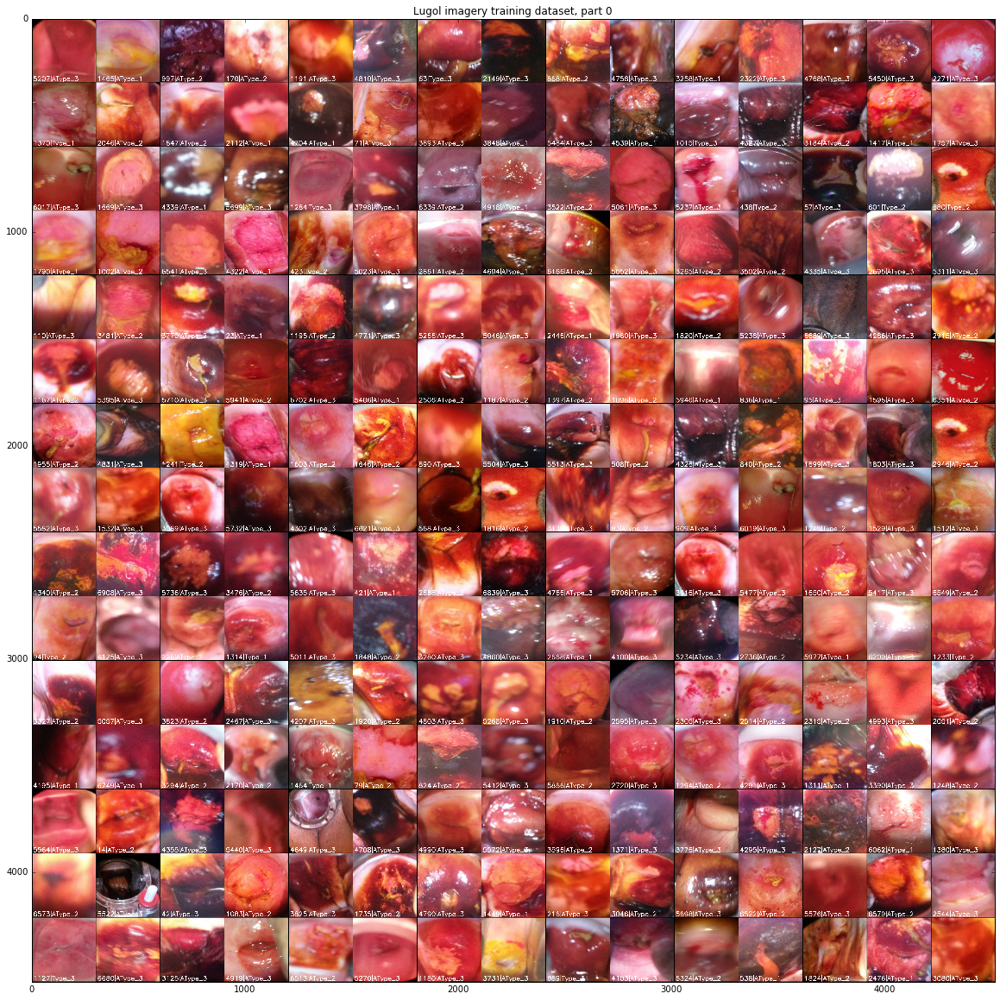

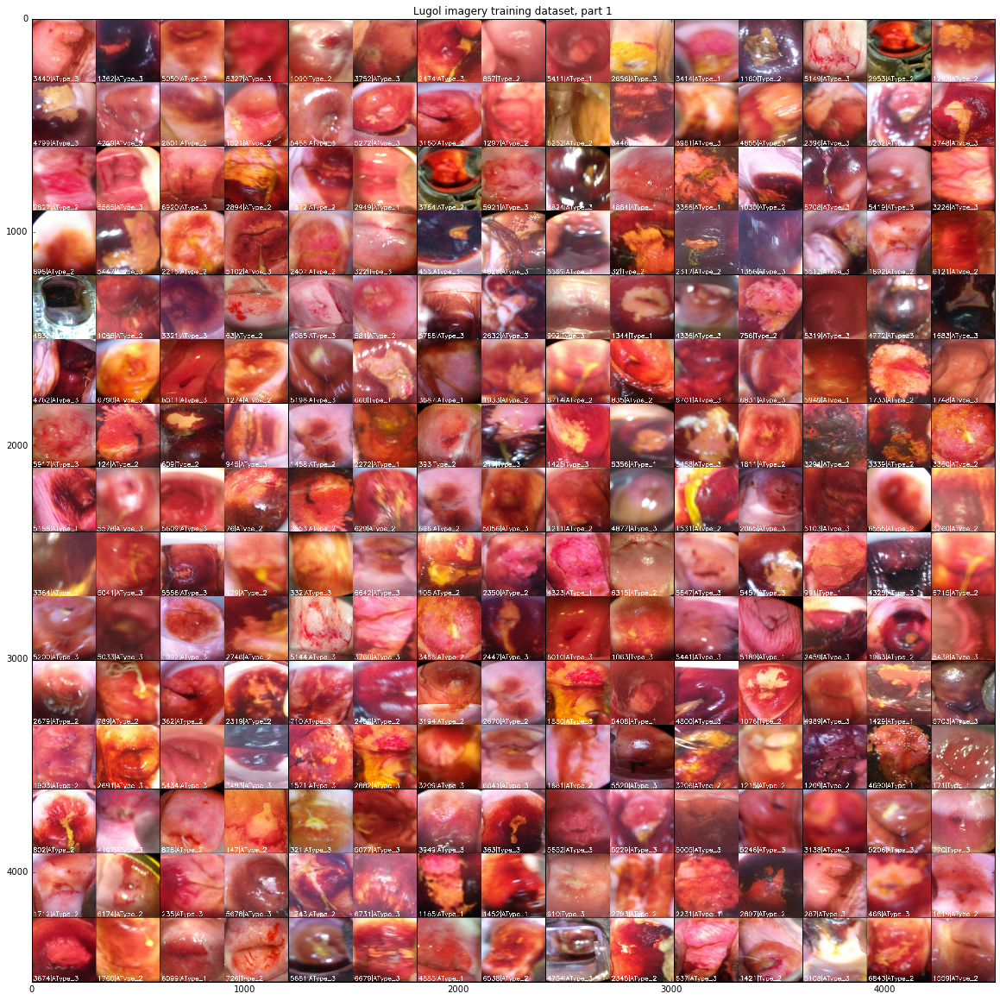

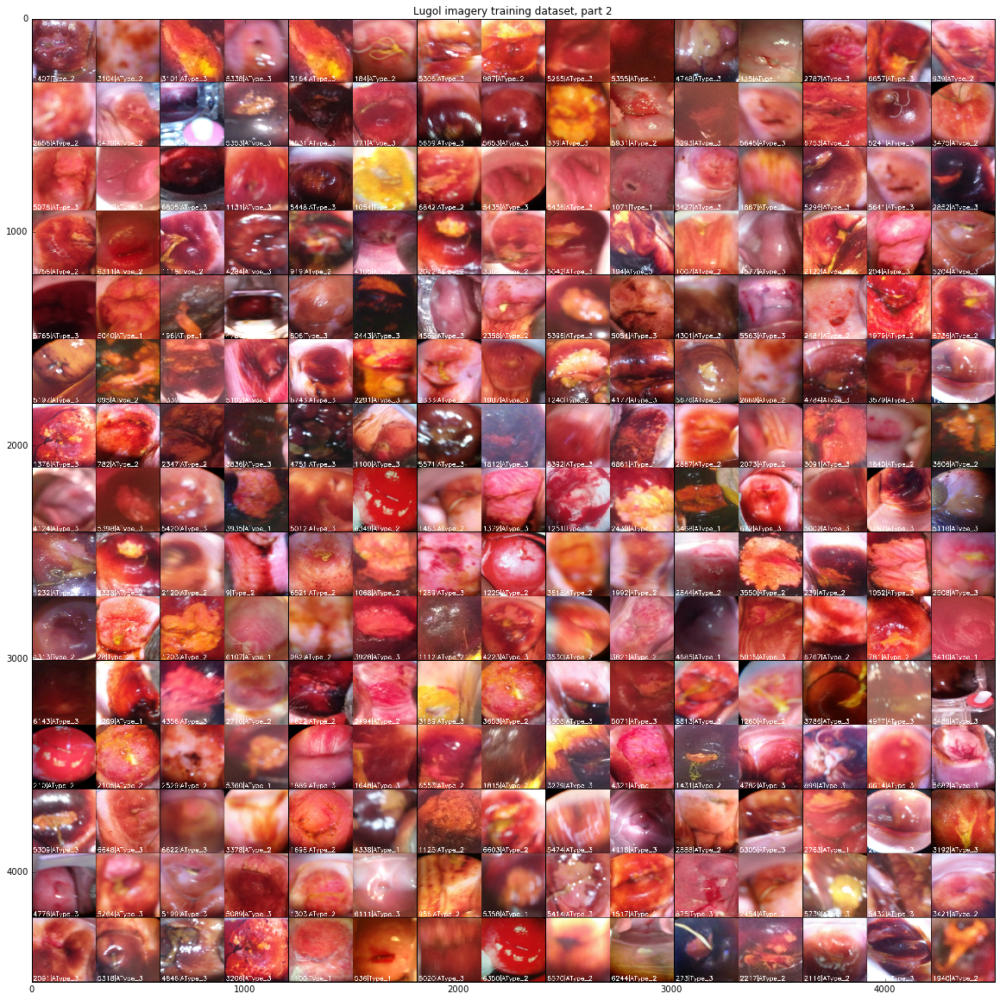

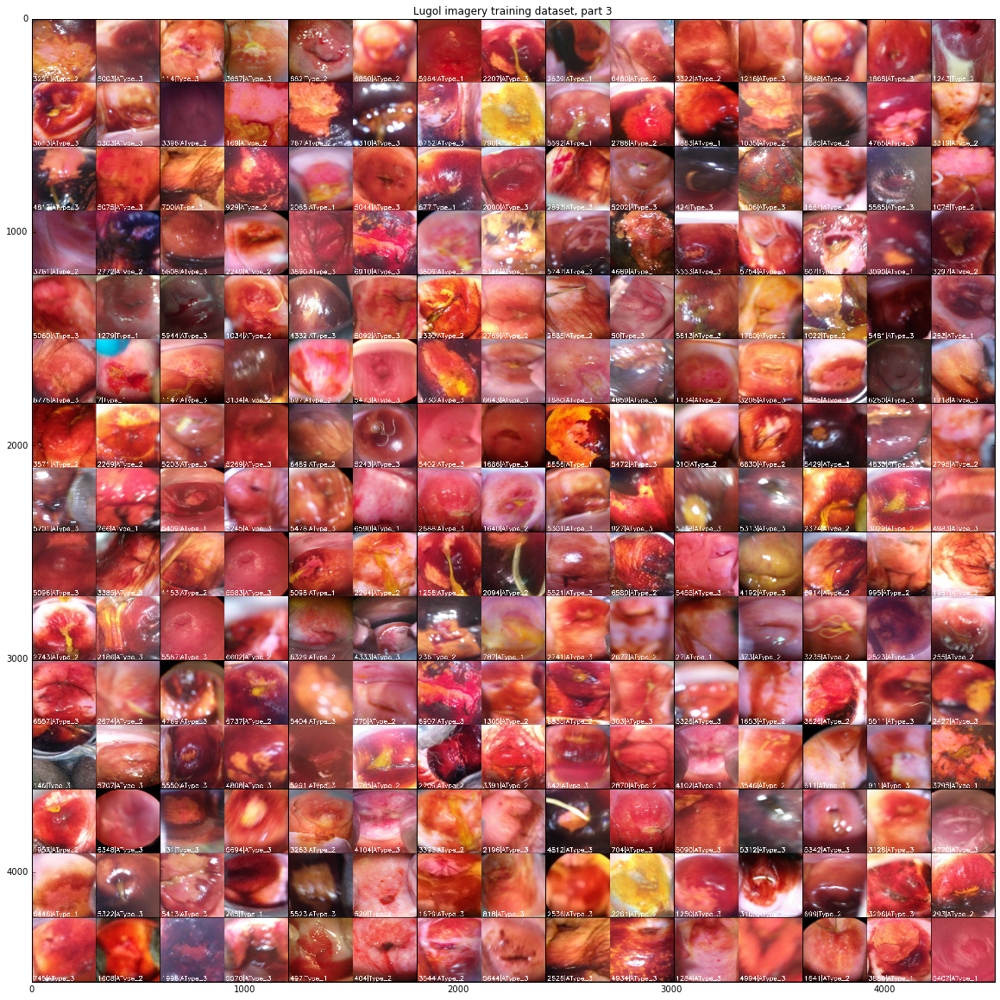

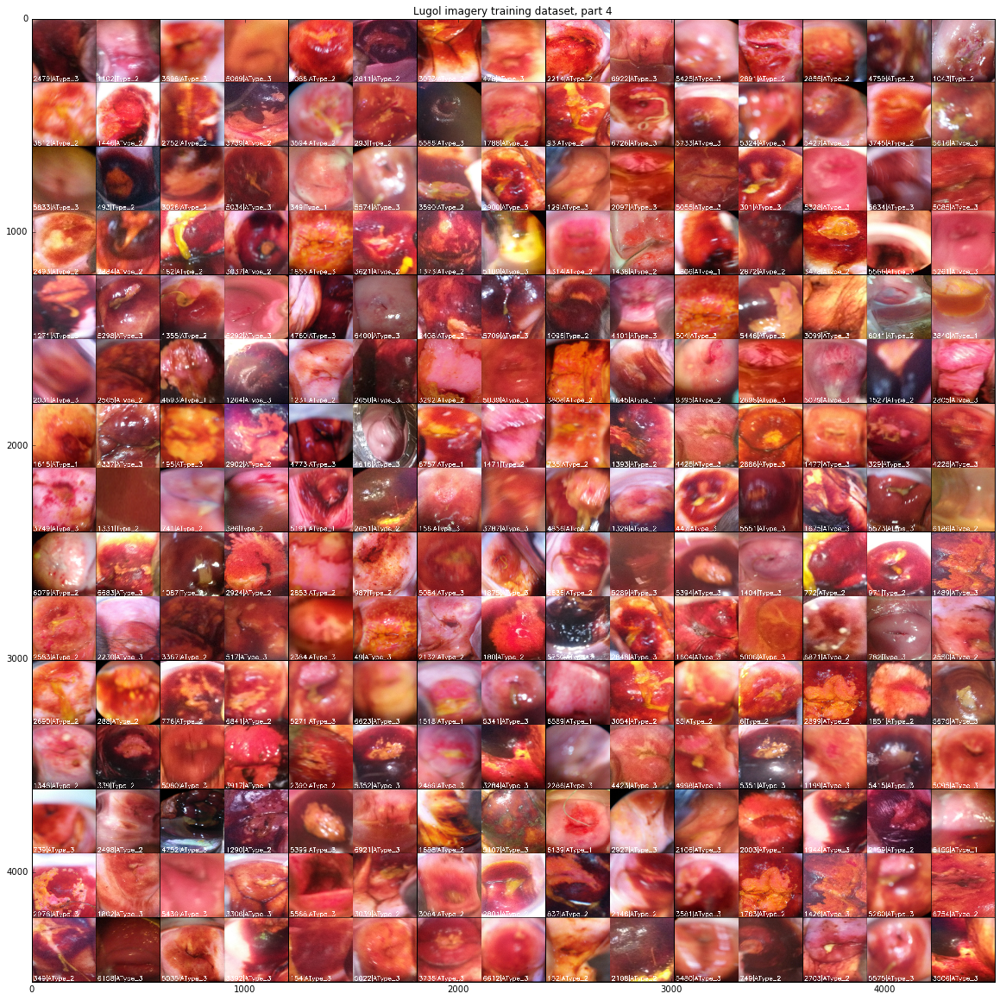

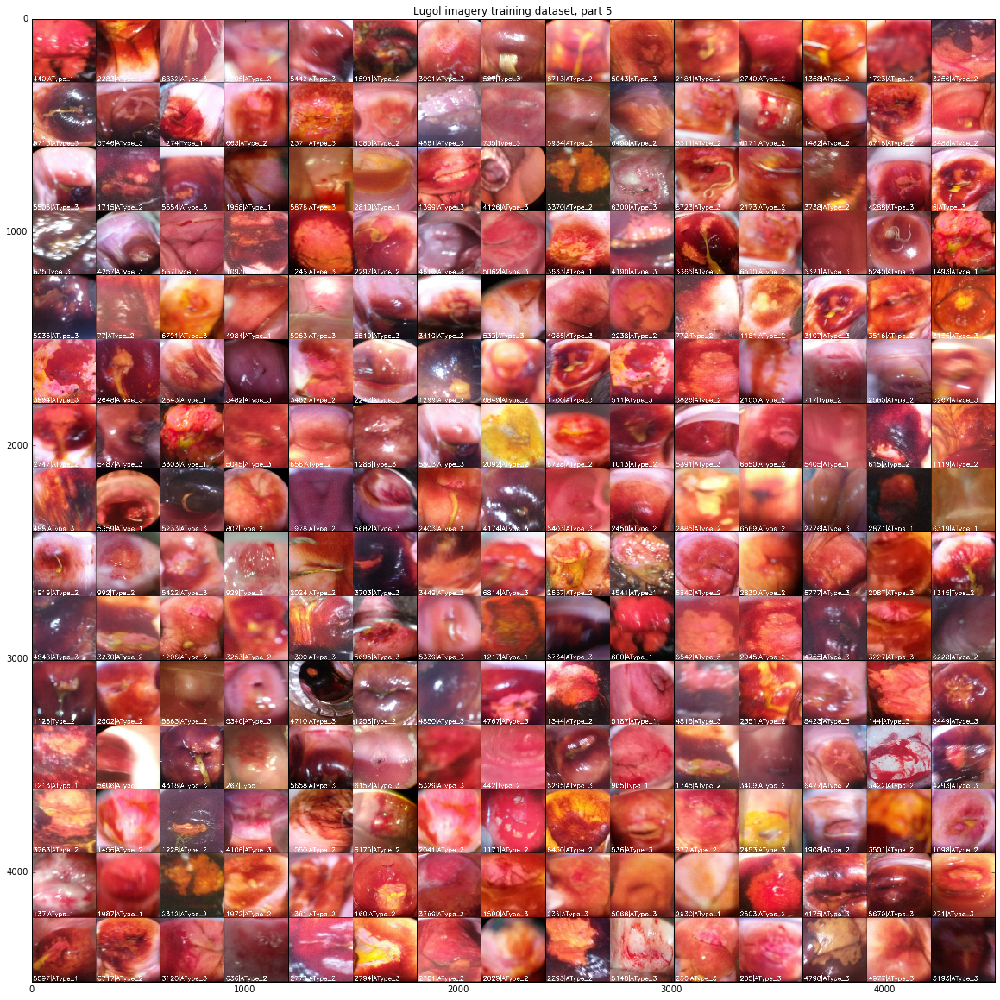

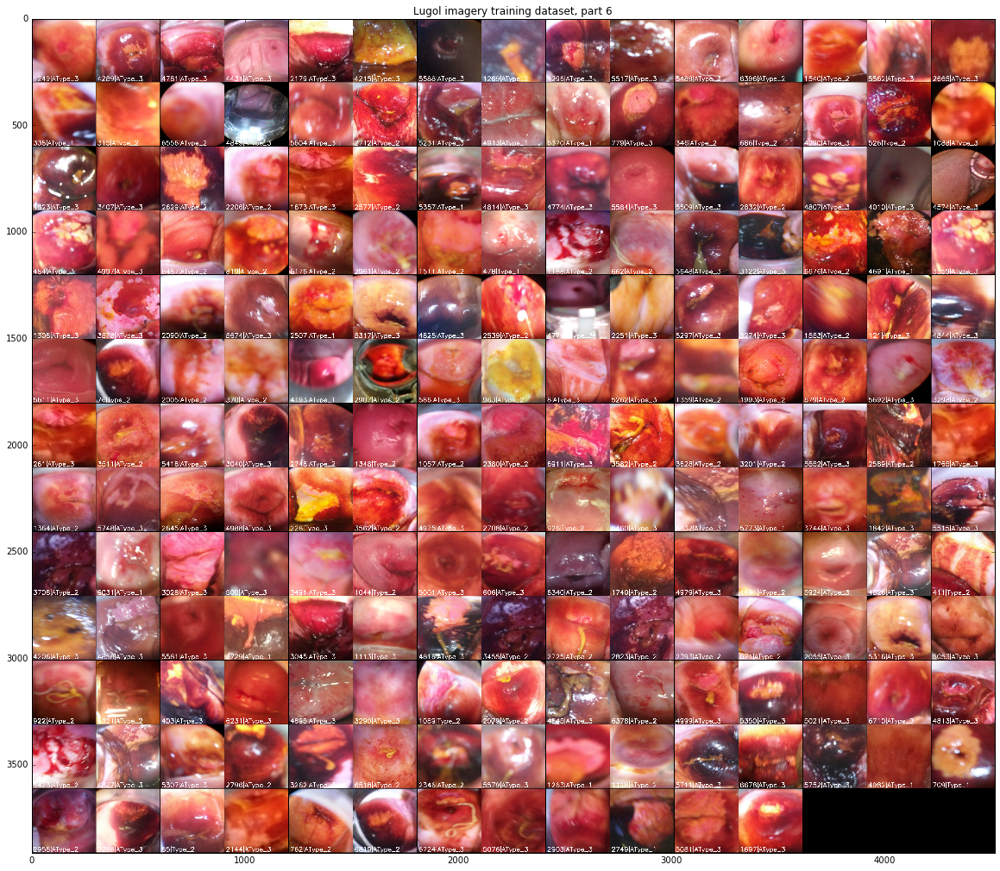

In [158]:
m = complete_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*15
    ye = min((i+1)*(tile_size[0] + 2)*15, complete_image.shape[0])
    plt.imshow(complete_image[ys:ye,:,:])
    plt.title("Lugol imagery training dataset, part %i" % (i))

#### Display test lugol images

In [162]:
id_type_list = test_lugol_id_type_list_final

tile_size = (224, 224)
n = 15

complete_image = []
m = int(np.ceil(len(id_type_list) * 1.0 / n))
complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
counter = 0

p = xy_provider(id_type_list,
                cache=cache,
                image_size=tile_size)


for i in range(m):
    ys = i*(tile_size[1] + 2)
    ye = ys + tile_size[1]
    for j in range(n):
        xs = j*(tile_size[0] + 2)
        xe = xs + tile_size[0]
        if counter == len(id_type_list):
            break
        image_id, image_type = id_type_list[counter]; counter+=1
        print "--", counter, "/", len(id_type_list), image_id, image_type    
        
        img, _, info = p.next()
        img = img.transpose([1, 2, 0])
        img = (255.0 * img).astype(np.uint8)
        #img = get_cervix_image(image_id, image_type)                    
        #img = cv2.resize(img, dsize=tile_size)
        img = cv2.putText(img, image_id + "|" + image_type, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 255, 255), thickness=2)
        complete_image[ys:ye, xs:xe, :] = img[:,:,:]
    
    if counter == len(id_type_list):
        break         

-- 1 / 41 102 Test
-- 2 / 41 271 Test
-- 3 / 41 451 Test
-- 4 / 41 478 Test
-- 5 / 41 368 Test
-- 6 / 41 484 Test
-- 7 / 41 60 Test
-- 8 / 41 226 Test
-- 9 / 41 116 Test
-- 10 / 41 32 Test
-- 11 / 41 149 Test
-- 12 / 41 130 Test
-- 13 / 41 242 Test
-- 14 / 41 475 Test
-- 15 / 41 455 Test
-- 16 / 41 148 Test
-- 17 / 41 250 Test
-- 18 / 41 247 Test
-- 19 / 41 463 Test
-- 20 / 41 445 Test
-- 21 / 41 292 Test
-- 22 / 41 168 Test
-- 23 / 41 172 Test
-- 24 / 41 55 Test
-- 25 / 41 155 Test
-- 26 / 41 166 Test
-- 27 / 41 46 Test
-- 28 / 41 119 Test
-- 29 / 41 381 Test
-- 30 / 41 66 Test
-- 31 / 41 174 Test
-- 32 / 41 97 Test
-- 33 / 41 426 Test
-- 34 / 41 103 Test
-- 35 / 41 62 Test
-- 36 / 41 419 Test
-- 37 / 41 230 Test
-- 38 / 41 404 Test
-- 39 / 41 210 Test
-- 40 / 41 158 Test
-- 41 / 41 461 Test


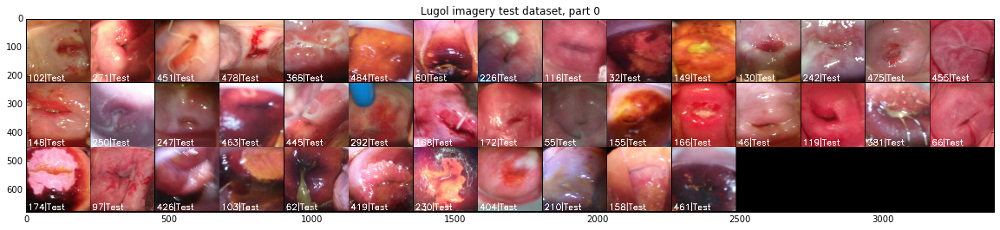

In [163]:
m = complete_image.shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*15
    ye = min((i+1)*(tile_size[0] + 2)*15, complete_image.shape[0])
    plt.imshow(complete_image[ys:ye,:,:])
    plt.title("Lugol imagery test dataset, part %i" % (i))

### Generate lists of normal imagery

In [164]:
trainval_normal_id_type_list = list(trainval_lugol_normal_id_type_list)
trainval_normal_id_type_list = list(set(trainval_normal_id_type_list) - set(lugol_id_type_list_final))
print len(trainval_normal_id_type_list)

test_normal_id_type_list = list(test_lugol_normal_id_type_list)
test_normal_id_type_list = list(set(test_normal_id_type_list) - set(test_lugol_id_type_list_final))
print len(test_normal_id_type_list)


4977
471


In [166]:
np.savez_compressed(os.path.join(GENERATED_DATA, "normal_id_type_list.npz"), normal_id_type_list=trainval_normal_id_type_list)
np.savez_compressed(os.path.join(GENERATED_DATA, "test_normal_id_type_list.npz"), test_normal_id_type_list=test_normal_id_type_list)